In [1]:
import numpy as np
import pandas as pd
from scipy.fft import fft, ifft

import os
import glob

In [2]:
import geopandas as gpd

In [3]:
import statistics

In [4]:
import datetime

In [5]:
import matplotlib.pyplot as plt
plt.rcParams["figure.figsize"] = (12, 5)

In [6]:
data_root = os.path.join("data","san-fransisco")

In [86]:
footprints = gpd.read_file(os.path.join(data_root, "footprints.geojson"), crs=4326)

In [87]:
sin_compression = pd.read_csv(os.path.join(data_root, "sinusoid_compression.csv"))
sin_compression['id'] = sin_compression.id.astype(str)

In [88]:
sfboundaries = gpd.read_file(os.path.join(data_root, "sfboundaries.geojson"))

In [89]:
footprint_bias = footprints.merge(
    sin_compression,
    left_on="id",
    right_on="id"
)

In [90]:
footprint_bias

,id,geometry,Unnamed: 0,amplitude,bias,xbias
0,16920736097675959992,"MULTIPOLYGON (((-122.47735 37.72890, -122.4773...",0,9.837019,28.185936,-0.069063
1,3716934803218916779,"MULTIPOLYGON (((-122.41097 37.77099, -122.4109...",1,12.318524,31.941373,0.076386
2,5307086460531864172,"MULTIPOLYGON (((-122.40679 37.73929, -122.4067...",2,10.989874,30.250306,0.036364
3,3447810801610675457,"MULTIPOLYGON (((-122.40633 37.78493, -122.4063...",3,10.927193,30.477853,0.068415
4,15467705435019540398,"MULTIPOLYGON (((-122.40815 37.76651, -122.4087...",4,12.602447,32.202208,0.064525
...,...,...,...,...,...,...
1658,8058314152256903896,"MULTIPOLYGON (((-122.48005 37.71957, -122.4801...",1658,9.588437,26.218928,-0.065664
1659,17068604419902995873,"MULTIPOLYGON (((-122.47818 37.71578, -122.4781...",1659,9.561712,28.232208,-0.072806
1660,12316457636555025184,"MULTIPOLYGON (((-122.48429 37.71586, -122.4842...",1660,8.685526,25.417980,-0.064964
1661,17582837908432294491,"MULTIPOLYGON (((-122.47999 37.71675, -122.4800...",1661,9.453897,27.080601,-0.038137


In [91]:
sfboundaries.explore()

In [145]:
sf_subset = sfboundaries[sfboundaries.name.isin([
    "North Beach",
    "Telegraph Hill",
    "Chinatown",
    "Financial District",
    "Downtown / Union Square",
    "South of Market",
    "Rincon Hill",
    "South Beach",
    "Nob Hill",
    "Lower Nob Hill",
    "Tenderloin",
    "Northern Waterfront"
])]

In [146]:
from shapely.ops import cascaded_union
sf_subset_region = gpd.GeoSeries(
    cascaded_union(sf_subset.geometry),
    crs = 4326
)

/tmp/ipykernel_11743/1603555451.py:3: ShapelyDeprecationWarning: The 'cascaded_union()' function is deprecated. Use 'unary_union()' instead.
  cascaded_union(sf_subset.geometry),


In [147]:
gpd.GeoDataFrame(sf_subset_region)

,0
0,"POLYGON ((-122.40166 37.77182, -122.40321 37.7..."


In [148]:
building_idxs = gpd.GeoDataFrame(geometry=sf_subset_region, crs=4326).sjoin(
    footprint_bias,
    predicate="contains"
).index_right

In [149]:
footprint_bias.iloc[building_idxs]

,id,geometry,Unnamed: 0,amplitude,bias,xbias
479,3147103899040185915,"MULTIPOLYGON (((-122.40136 37.77223, -122.4013...",479,12.213004,31.618484,0.057693
1196,2941663811996779889,"MULTIPOLYGON (((-122.40071 37.77381, -122.4006...",1196,12.086518,31.760697,0.074911
722,3941312186787088597,"MULTIPOLYGON (((-122.40027 37.77720, -122.4002...",722,11.920286,31.379186,0.069816
541,7588830513043485263,"MULTIPOLYGON (((-122.40155 37.77976, -122.4013...",541,11.532080,30.955478,0.075687
277,7823486000169176260,"MULTIPOLYGON (((-122.40002 37.78003, -122.4003...",277,11.504888,30.344036,0.058807
...,...,...,...,...,...,...
1374,5868629992373364250,"MULTIPOLYGON (((-122.40914 37.80075, -122.4090...",1374,11.223950,29.059110,0.083737
1398,8561682590674261143,"MULTIPOLYGON (((-122.40918 37.80093, -122.4088...",1398,11.241020,29.173644,0.079492
1649,7493855468280612781,"MULTIPOLYGON (((-122.41009 37.80190, -122.4100...",1649,11.348838,29.458433,0.077933
903,7106532666917250693,"MULTIPOLYGON (((-122.41120 37.80584, -122.4111...",903,11.052643,30.055195,0.084681


In [152]:
plot_footprints.iloc[building_idxs].explore("bias")

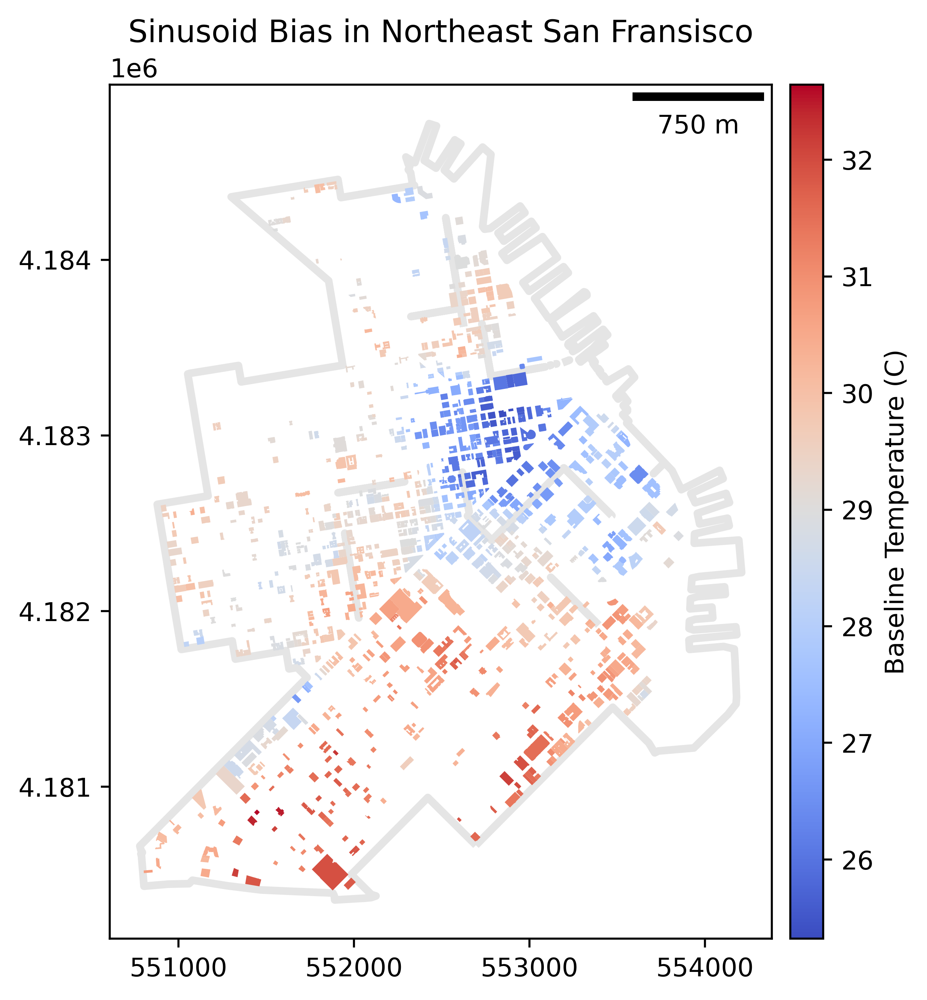

In [164]:
import copy
from matplotlib_scalebar.scalebar import ScaleBar
from mpl_toolkits.axes_grid1 import make_axes_locatable

fig, ax = plt.subplots(figsize=(6, 6), dpi=500)
plt.locator_params(axis='x', nbins=4)

plot_boundary = copy.deepcopy(sf_subset_region)
plot_boundary = plot_boundary.to_crs(32610)

plot_footprints = copy.deepcopy(footprint_bias)
plot_footprints['geometry'] = plot_footprints.geometry.to_crs(32610)

plt.title("Sinusoid Bias in Northeast San Fransisco")

divider = make_axes_locatable(ax)
cax = divider.append_axes("right", size="5%", pad=0.1)

plot_boundary.plot(ax=ax, alpha=0.1, facecolor="none", edgecolor='black', lw=3)
plot_footprints.iloc[building_idxs].plot(
    "bias", 
    ax=ax,
    cmap="coolwarm",
    legend=True,
    legend_kwds={'label': "Baseline Temperature (C)",
                        'orientation': "vertical"},
    cax=cax
)

ax.add_artist(ScaleBar(1))

plt.savefig('sf_tempbias.png')
plt.show()

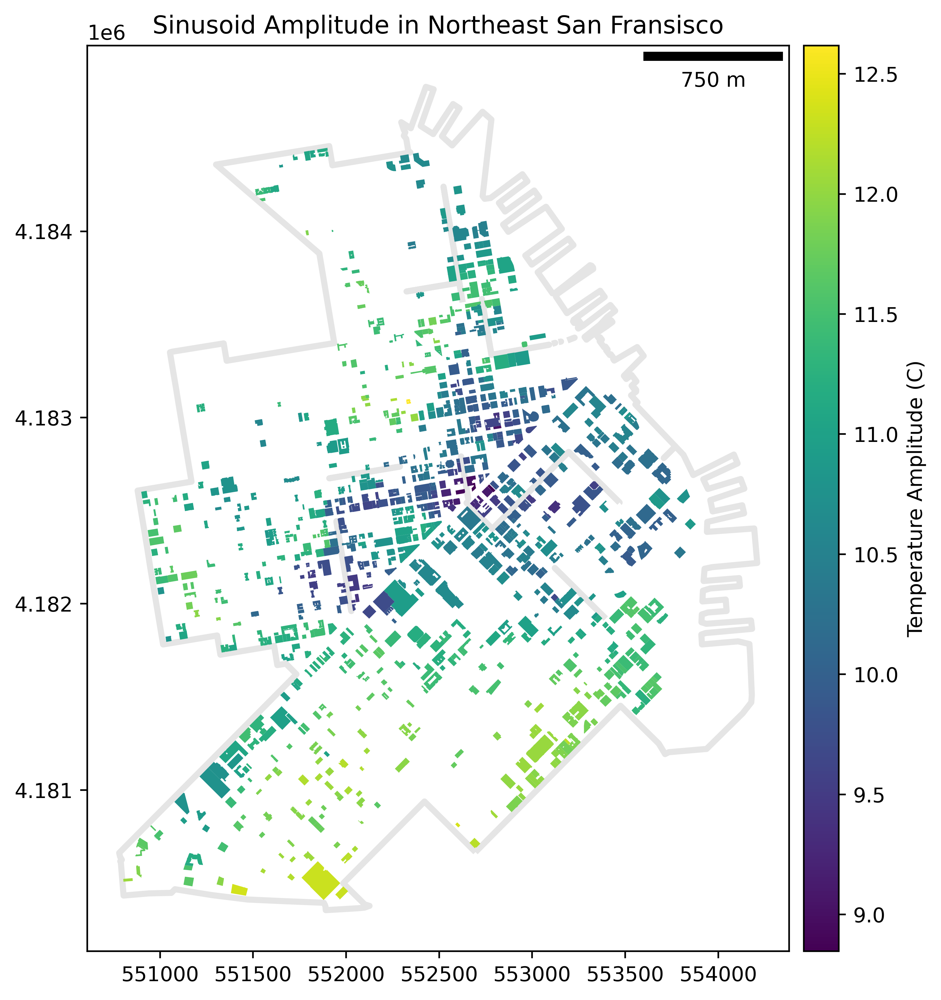

In [154]:
fig, ax = plt.subplots(figsize=(8, 8), dpi=500)

plot_boundary = copy.deepcopy(sf_subset_region)
plot_boundary = plot_boundary.to_crs(32610)

plot_footprints = copy.deepcopy(footprint_bias)
plot_footprints['geometry'] = plot_footprints.geometry.to_crs(32610)

plt.title("Sinusoid Amplitude in Northeast San Fransisco")

divider = make_axes_locatable(ax)
cax = divider.append_axes("right", size="5%", pad=0.1)

plot_boundary.plot(ax=ax, alpha=0.1, facecolor="none", edgecolor='black', lw=3)
plot_footprints.iloc[building_idxs].plot(
    "amplitude", 
    ax=ax,
    cmap="viridis",
    legend=True,
    legend_kwds={'label': "Temperature Amplitude (C)",
                        'orientation': "vertical"},
    cax=cax
)

ax.add_artist(ScaleBar(1))

plt.savefig('sf_tempamplitude.png')
plt.show()

<AxesSubplot: >

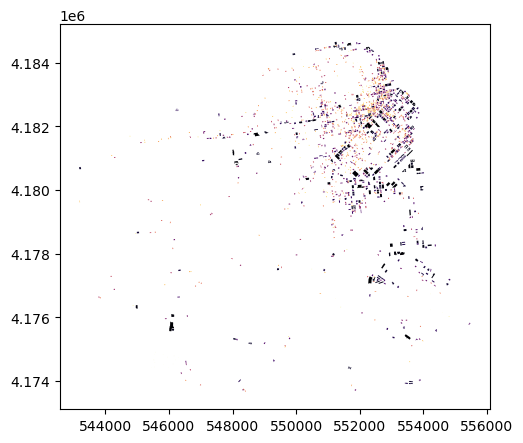

In [114]:
plot_footprints.plot(cmap="inferno")

In [108]:
plot_boundary.to_crs

<bound method GeoSeries.to_crs of 0    POLYGON ((-122.40166 37.77182, -122.40321 37.7...
dtype: geometry>

In [24]:
footprints.merge(
    sin_compression,
    left_on="id",
    right_on="id"
).explore(
    "bias",
    tiles="CartoDB positron"
)

In [7]:
landsat = pd.concat(
    map(
        pd.read_csv,
        glob.glob(os.path.join(data_root,'landsat8*.csv'))
    ), 
    ignore_index= True
)

In [8]:
landsat.ST_B10 = landsat.ST_B10 * 0.00341802 + 149 - 273.15
landsat.ST_QA = landsat.ST_QA * 0.01
landsat = landsat.dropna()

landsat.date = pd.to_datetime(landsat.date)
landsat = landsat.set_index("date")
# landsat.sort_values(by=["id","date"], inplace=True)

# landsat = landsat.set_index('id', append=True)

# landsat = landsat.resample('M').mean().ffill()


# landsat = landsat[['id','ST_B10','ST_QA']]
# landsat['ST_B10'] = landsat.groupby('id')['ST_B10'].transform(lambda v: v.resample('M').mean().ffill())
# landsat['ST_QA'] = landsat.groupby('id')['ST_QA'].transform(lambda v: v.resample('M').mean().ffill())
# landsat = landsat.dropna()
# landsat

In [9]:
landsat

,id,ST_B10,ST_QA,ST_ATRAN,ST_CDIST,ST_DRAD,ST_EMIS,ST_EMSD,ST_TRAD,ST_URAD,SR_B1,SR_B2,SR_B3,SR_B4,SR_B5,SR_B6,SR_B7,NDVI
date,,,,,,,,,,,,,,,,,,
2013-08-29 15:35:44,15694550116658875118,29.718447,6.551090,5352.828660,8.696262,1579.760125,9666.384735,120.255452,8774.917445,3557.760125,9171.012461,9353.333333,10466.702492,9959.993769,12089.325545,11734.386293,10771.423676,0.096401
2013-08-29 15:35:44,2870189493694989714,28.083870,6.012495,5315.000000,18.655914,1591.000000,9700.270968,97.419355,8657.623656,3585.000000,7792.834409,7925.262366,8962.673118,8386.965591,9783.249462,9320.535484,8755.619355,0.076834
2013-08-29 15:35:44,15000060415568634295,30.655358,5.828480,5363.066922,20.555449,1576.933078,9683.801147,67.502868,8856.568834,3550.227533,10138.970363,10345.536329,11338.413958,11163.995220,13332.533461,13103.418738,11843.538241,0.086373
2013-08-29 15:35:44,5096121962873423096,31.961009,6.329284,5322.383632,11.007673,1589.000000,9650.381074,83.534527,8930.578005,3580.000000,10361.319693,10576.833760,11601.562660,11334.312020,14800.273657,14125.698210,12707.634271,0.131275
2013-08-29 15:35:44,18024117210968761415,32.645554,6.470199,5351.831117,8.551862,1580.000000,9583.378989,122.263298,8958.761968,3558.168883,11774.912234,12049.920213,12955.300532,12951.941489,15710.672872,15843.352394,14419.223404,0.096917
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2017-12-21 15:40:04,13403349287652399441,5.740822,6.039313,9216.000000,5.557252,223.000000,9634.137405,99.249364,6508.496183,405.000000,9000.954198,9425.437659,10211.804071,10587.839695,12155.847328,12782.071247,11518.951654,0.068803
2017-12-21 15:40:04,13569713358266207507,6.394730,5.262073,9232.459350,20.548780,218.000000,9765.502710,34.722222,6657.688347,394.000000,9403.191057,9677.479675,10252.735772,10571.254743,14171.742547,14167.392954,12149.033875,0.143175
2017-12-21 15:40:04,13569713358266207507,5.832125,5.409522,9238.017937,18.028401,216.000000,9653.932735,62.275037,6529.227205,390.000000,9063.778774,9317.825112,9727.019432,10086.801196,11768.345291,12062.856502,11262.917788,0.076809


In [10]:
import math
def periodic_function(X, amplitude, bias, xbias):
    return amplitude * np.sin(((2*math.pi)/12) * X + xbias) + bias

In [11]:
from scipy.optimize import curve_fit
from dateutil import relativedelta

def develop_curve(values):
    popt, pcov = curve_fit(
        periodic_function,  # our function
        np.arange(len(values)),  # measured x values
        values,  # measured y values
        p0=(30.0, 20, -1)
    )  # the initial guess for the two parameters
    return popt

unique_ids = landsat.id.unique()
popts = []

for unique_id in unique_ids:
    sample_landsat = landsat.loc[landsat.id == unique_id]["ST_B10"].resample('M').mean().ffill()
    popts.append(develop_curve(sample_landsat))
    
popts = np.array(popts)

In [12]:
unique_ids.astype(str)

array(['15694550116658875118', '2870189493694989714',
       '15000060415568634295', ..., '12994420514742894881',
       '154222330203094048', '2622784006584057104'], dtype='<U20')

In [13]:
periodic_regression = pd.DataFrame({
    "id":unique_ids.astype(str), 
    "amplitude":popts[:,0],
    "bias":popts[:,1],
    "xbias": popts[:,2]
#     "bias":popts[:,2]
})

# periodic_regression["id"]| = period_regression.id.astype(str)

In [14]:
footprints = gpd.read_file(os.path.join(data_root,"footprints.geojson"))

In [15]:
footprint_data = footprints.merge(
    periodic_regression, 
    left_on="id", 
    right_on="id"
)

In [16]:
image_dir = os.path.join(data_root, "images")
# os.makedirs(image_dir)

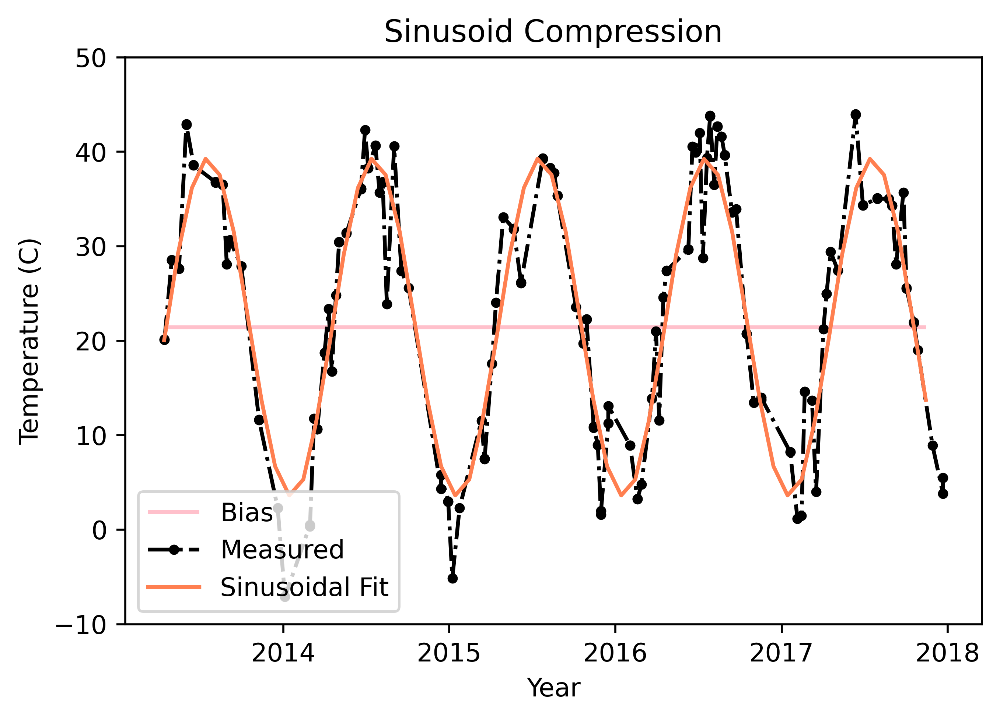

In [41]:
from dateutil import relativedelta

single_id = '2870189493694989714'

landsat_sample = landsat.loc[landsat.id == int(single_id),:].sort_index()
landsat_results = periodic_regression.loc[periodic_regression.id == single_id, :].iloc[0]

min_date = landsat_sample.index.min().date()
max_date = landsat_sample.index.max().date()

deltas = relativedelta.relativedelta(max_date, min_date)
delta_months = deltas.months + (12*deltas.years)
sample_dates = [ min_date + pd.DateOffset(months=x) for x in np.arange(delta_months) ]

sample_fit =  periodic_function(
    np.arange(len(sample_dates)), 
    landsat_results.amplitude, 
    landsat_results.bias,
    landsat_results.xbias
)

fig, ax = plt.subplots(1, 1, dpi=500, figsize=(6,4))
plt.hlines(landsat_results.bias, min(sample_dates), max(sample_dates), color="pink", label="Bias")

ax.plot(
    landsat_sample.index, 
    landsat_sample.ST_B10, 
    '.-.', 
    label='Measured', 
    color="black",
)
ax.plot(
    sample_dates, 
    sample_fit, 
    label='Sinusoidal Fit', 
    color="coral"
)
ax.legend()

plt.ylabel("Temperature (C)")
plt.xlabel("Year")
plt.title("Sinusoid Compression")
plt.ylim(-10, 50)

plt.plot()
plt.savefig(os.path.join(image_dir,'sin_encode.png'), bbox_inches='tight')

In [30]:
landsat_results

id           2870189493694989714
amplitude              17.868847
bias                   21.436864
xbias                  -0.077445
Name: 1, dtype: object

In [36]:
landsat_results.bias + landsat_results.amplitude

39.30571018254656

In [28]:
footprint_data[footprint_data.id == single_id].explore()

In [18]:
footprint_data.explore(
    "amplitude", 
    tiles="CartoDB positron",
    popup=True
)

In [ ]:
periodic_regression.to_csv(
    os.path.join(
        data_root,
        "landsat_compression.csv"
    )
)